# Phân Loại Hoa Sử dụng CNN

# Gọi Thư Viện Cần Thiết


In [1]:
# Import Libraries
import numpy as np
import pandas as pd
import os
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
import seaborn as sns 
import random
from collections import Counter

import cv2
from tensorflow.keras.regularizers import l1, l2
from PIL import Image
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers, models
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping

# Load the dataset

In [2]:
data_train = '/kaggle/input/flowers-dataset/train'

In [3]:
flowers = {}

for dirname, dirlist, filenames in os.walk(data_train):
    flower_name = dirname.split('/')[-1]
    if dirname != data_train:
        print(f"Number of {flower_name} images: {len(filenames)}")
        filePaths = []
        for filename in filenames:
            filePaths.append(os.path.join(data_train, dirname, filename))
        flowers[flower_name] = filePaths

Number of dandelion images: 646
Number of daisy images: 501
Number of sunflower images: 495
Number of tulip images: 607
Number of rose images: 497


# Display Sample of Images

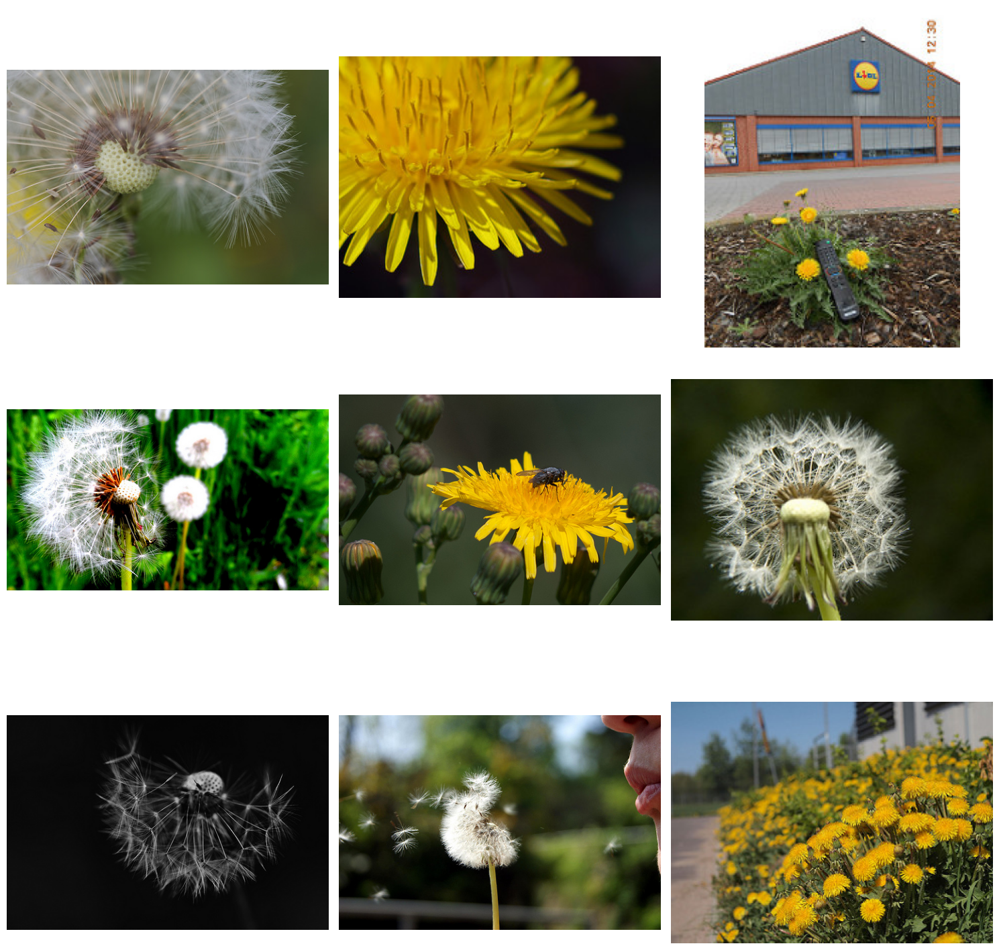

In [4]:
fig, ax = plt.subplots(3, 3, figsize=(15, 15))

# Display images in the 3x3 grid
for i in range(3): 
    for j in range(3): 
        img = cv2.imread(flowers[list(flowers.keys())[0]][i*3 + j])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        ax[i, j].imshow(img)
        # Hide axis for a cleaner look
        ax[i, j].axis('off')  

plt.tight_layout()
plt.show()

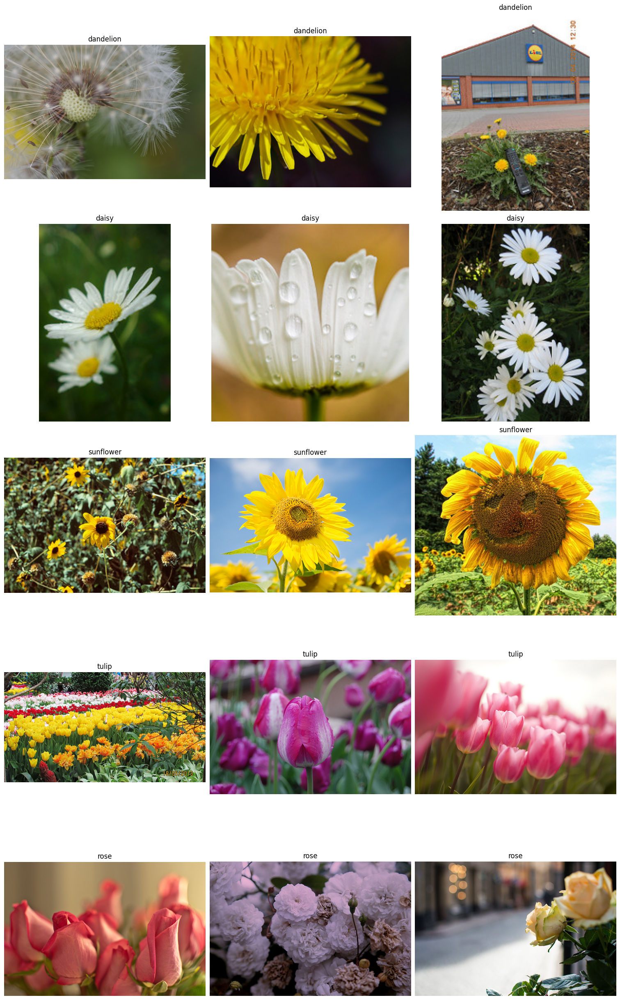

In [5]:
class_names = os.listdir(data_train)

fig, axs = plt.subplots(len(class_names), 3, figsize=(15, len(class_names) * 5), constrained_layout=True)

for i, cls in enumerate(class_names):
    cls_dir = os.path.join(data_train, cls)
    image_files = os.listdir(cls_dir)[:3]  
    for j, img_name in enumerate(image_files):
        img_path = os.path.join(cls_dir, img_name)
        img = Image.open(img_path)
        axs[i, j].imshow(img)
        axs[i, j].axis('off')
        axs[i, j].set_title(cls)

plt.show() 

# Greyscale Images

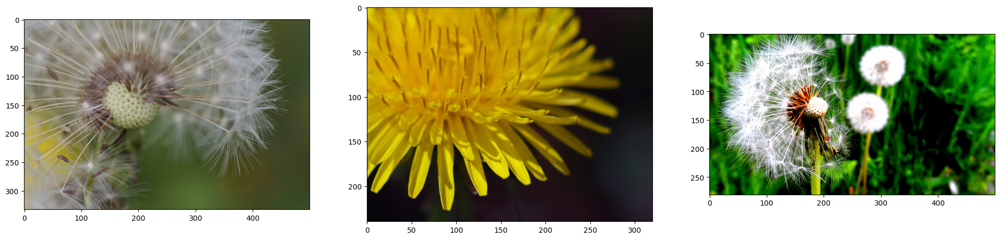

In [6]:
fig, ax = plt.subplots(1,3, figsize=(24, 12))

img1 = cv2.imread(flowers[list(flowers.keys())[0]][0])
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
ax[0].imshow(img1)

img2 = cv2.imread(flowers[list(flowers.keys())[0]][1])
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
ax[1].imshow(img2)

img3 = cv2.imread(flowers[list(flowers.keys())[0]][3])
img3 = cv2.cvtColor(img3, cv2.COLOR_BGR2RGB)
ax[2].imshow(img3)

plt.show()

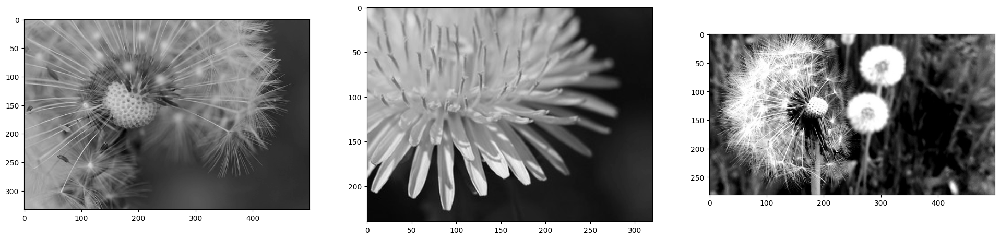

In [7]:
fig, ax = plt.subplots(1,3, figsize=(24, 12))

for idx, img in enumerate([img1, img2, img3]):
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    ax[idx].imshow(img_gray, cmap='gray')

plt.show()

# Count each image frequency

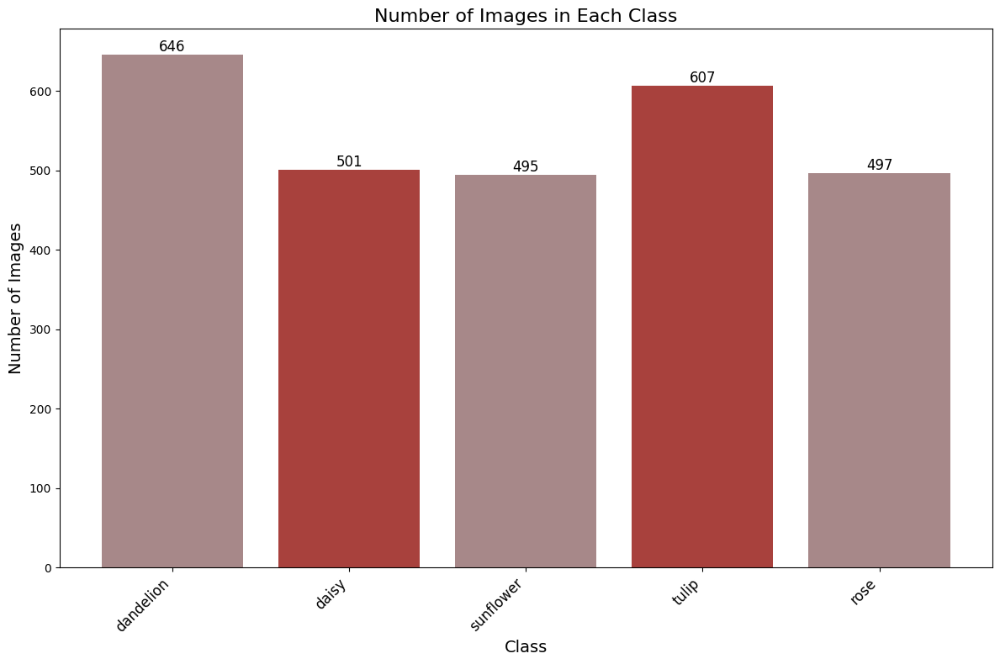

In [8]:
image_counts = {}
for cls in class_names:
    cls_dir = os.path.join(data_train, cls)
    num_images = len(os.listdir(cls_dir))
    image_counts[cls] = num_images

plt.figure(figsize=(12, 8))  
bars = plt.bar(image_counts.keys(), image_counts.values(), color=['#a78889', '#a8413d']) 

plt.xlabel('Class', fontsize=14)
plt.ylabel('Number of Images', fontsize=14)
plt.title('Number of Images in Each Class', fontsize=16)

plt.xticks(rotation=45, ha='right', fontsize=12)

for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height, f'{height}', ha='center', va='bottom', fontsize=12)

plt.tight_layout()
plt.show()

# Image Processing

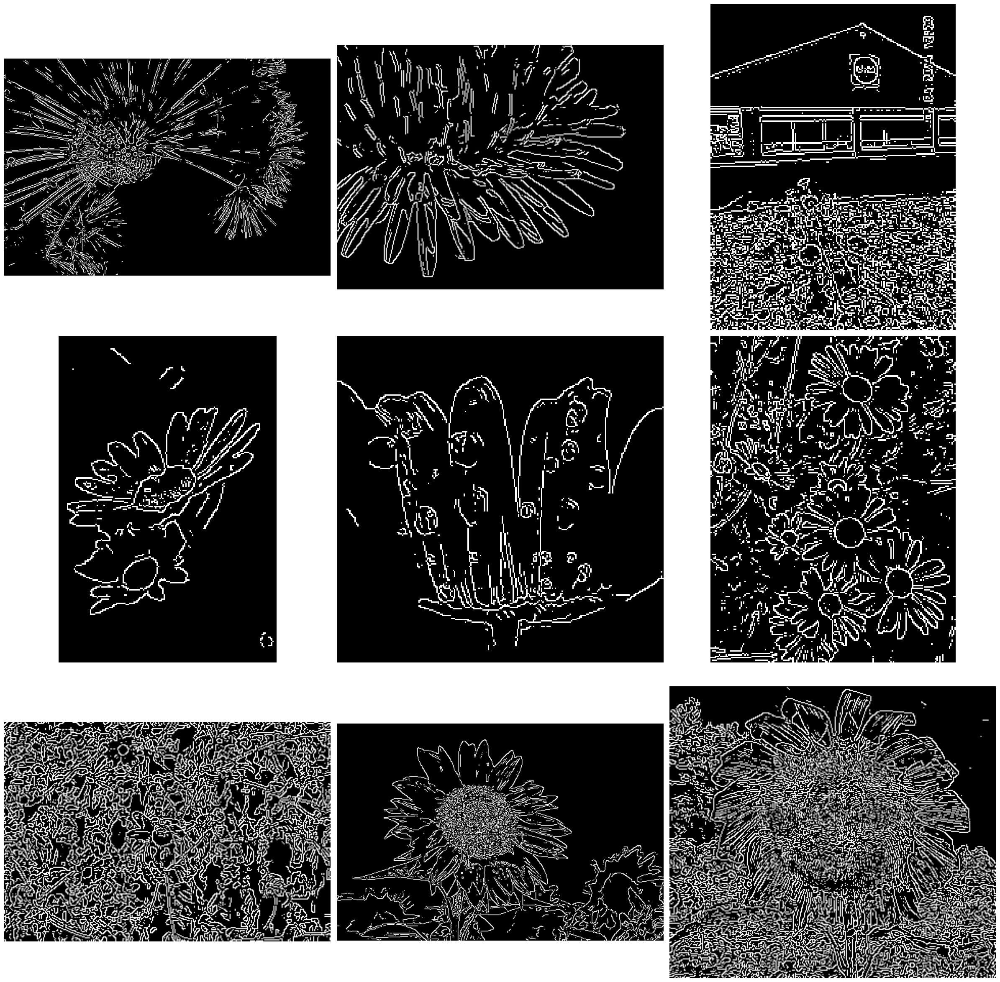

In [9]:
#Edge Detection
fig, ax = plt.subplots(3, 3, figsize=(24, 24))

# Flatten the 2D axis array 
axes = ax.flatten()

# Retrieve 9 unique images from the flowers dictionary
image_paths = []
for flower_name, paths in flowers.items():
    image_paths.extend(paths[:3])  

# Extract 9 images from the paths
images_to_display = image_paths[:9]  

# Apply Canny edge detection and display
for idx, img_path in enumerate(images_to_display):
    img = cv2.imread(img_path)  
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB
    # Apply Canny edge detection
    img_edges = cv2.Canny(img_rgb, threshold1=127, threshold2=127)  
    axes[idx].imshow(img_edges, cmap='gray')
    axes[idx].axis('off') 

plt.tight_layout()
plt.show()

In [10]:
def apply_gradient(image_path):
    image = Image.open(image_path)
    
    image_array = np.array(image)
    
    height = image_array.shape[0]

    # Create a vertical gradient effect
    gradient = np.linspace(0, 1, height) 
    gradient = gradient[:, np.newaxis] 
    
    if image_array.ndim == 3: 
         # Color image (RGB)
        gradient = gradient.reshape(height, 1, 1)  
        gradient_image = image_array * gradient  
        # Grayscale image
    else:  
        gradient_image = image_array * gradient  

    # Clip values to be in the valid range (0-255)
    gradient_image = np.clip(gradient_image, 0, 255).astype(np.uint8)

    # Convert back to an image
    return Image.fromarray(gradient_image)

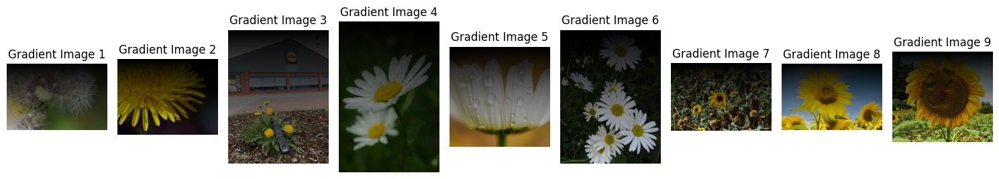

In [11]:
plt.figure(figsize=(15, 10))
for i, img_path in enumerate(images_to_display):
    gradient_img = apply_gradient(img_path)
    
    plt.subplot(1, len(images_to_display), i + 1)
    plt.imshow(gradient_img)
    plt.axis('off')
    plt.title(f'Gradient Image {i + 1}')

plt.tight_layout()
plt.show()

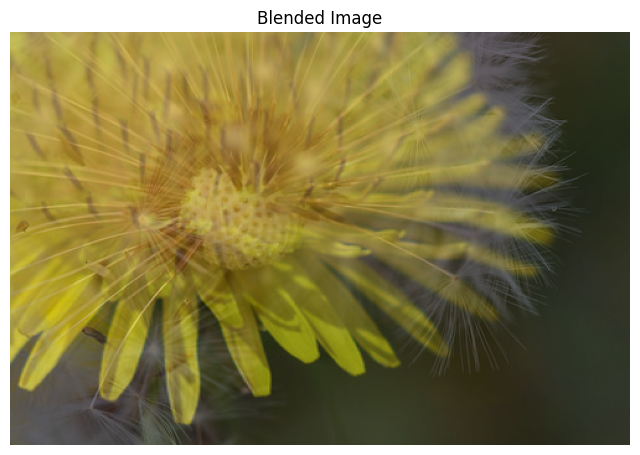

In [12]:
# Blend Images
image1 = cv2.imread(images_to_display[0])  
image2 = cv2.imread(images_to_display[1]) 

# Resize the second image to match the first image size
if image1.shape != image2.shape:
    image2 = cv2.resize(image2, (image1.shape[1], image1.shape[0]))

# Blend the images
blended_image = cv2.addWeighted(image1, 0.5, image2, 0.5, 0)

plt.figure(figsize=(8, 6))
plt.imshow(cv2.cvtColor(blended_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title('Blended Image')
plt.show()

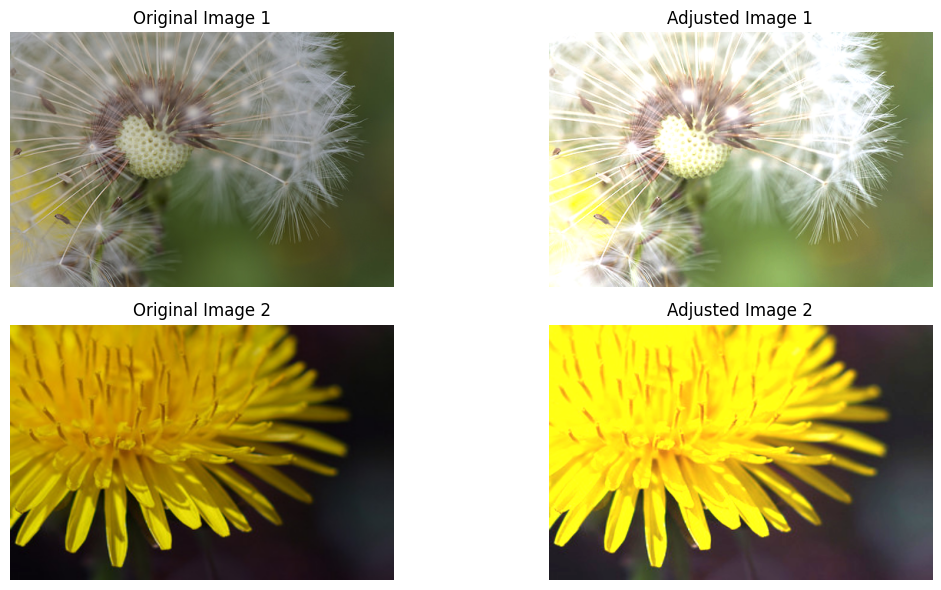

In [13]:
# Adjusting Contrast

# Contrast control 
alpha = 1.5 
# Brightness control
beta = 20   

adjusted_image1 = cv2.convertScaleAbs(image1, alpha=alpha, beta=beta)
adjusted_image2 = cv2.convertScaleAbs(image2, alpha=alpha, beta=beta)

plt.figure(figsize=(12, 6))

# Display original and adjusted images
plt.subplot(2, 2, 1)
plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for display
plt.title('Original Image 1')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(cv2.cvtColor(adjusted_image1, cv2.COLOR_BGR2RGB))
plt.title('Adjusted Image 1')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
plt.title('Original Image 2')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(cv2.cvtColor(adjusted_image2, cv2.COLOR_BGR2RGB))
plt.title('Adjusted Image 2')
plt.axis('off')

plt.tight_layout()
plt.show()

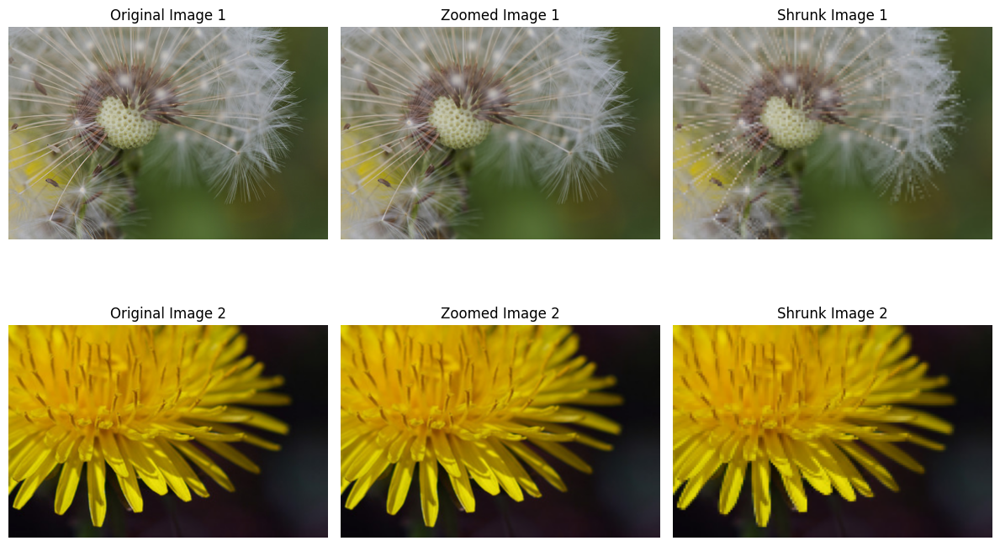

In [14]:
# Zooming & Shrinking

zoom_factor = 1.7  
shrink_factor = 0.3 

# Zoom in (larger size)
zoomed_image1 = cv2.resize(image1, None, fx=zoom_factor, fy=zoom_factor, interpolation=cv2.INTER_LINEAR)
zoomed_image2 = cv2.resize(image2, None, fx=zoom_factor, fy=zoom_factor, interpolation=cv2.INTER_LINEAR)

# Shrink (smaller size)
shrunk_image1 = cv2.resize(image1, None, fx=shrink_factor, fy=shrink_factor, interpolation=cv2.INTER_LINEAR)
shrunk_image2 = cv2.resize(image2, None, fx=shrink_factor, fy=shrink_factor, interpolation=cv2.INTER_LINEAR)

plt.figure(figsize=(12, 8))

plt.subplot(2, 3, 1)
plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
plt.title('Original Image 1')
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(cv2.cvtColor(zoomed_image1, cv2.COLOR_BGR2RGB))
plt.title('Zoomed Image 1')
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(cv2.cvtColor(shrunk_image1, cv2.COLOR_BGR2RGB))
plt.title('Shrunk Image 1')
plt.axis('off')

plt.subplot(2, 3, 4)
plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
plt.title('Original Image 2')
plt.axis('off')

plt.subplot(2, 3, 5)
plt.imshow(cv2.cvtColor(zoomed_image2, cv2.COLOR_BGR2RGB))
plt.title('Zoomed Image 2')
plt.axis('off')

plt.subplot(2, 3, 6)
plt.imshow(cv2.cvtColor(shrunk_image2, cv2.COLOR_BGR2RGB))
plt.title('Shrunk Image 2')
plt.axis('off')

plt.tight_layout()
plt.show()

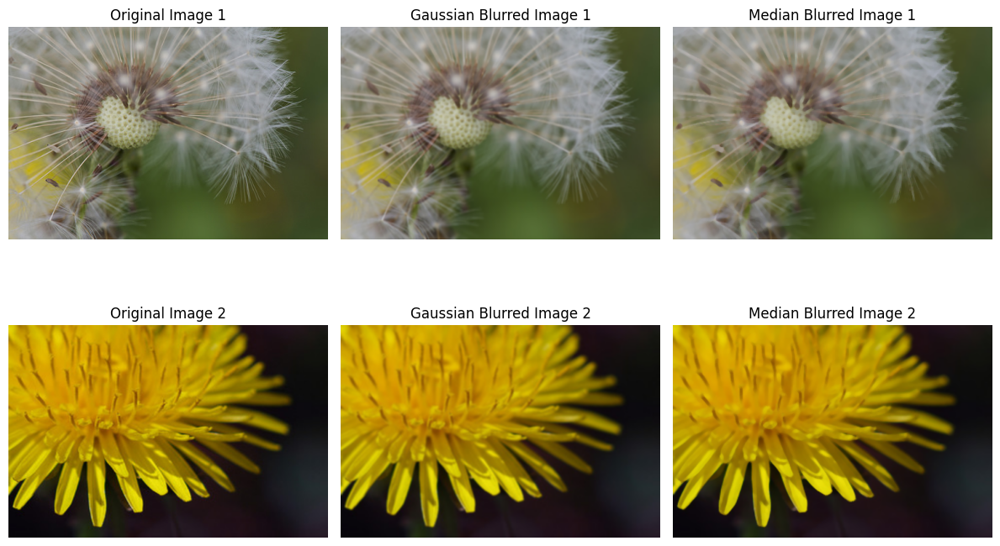

In [15]:
# Apply Gaussian Blur to reduce noise
gaussian_blurred_image1 = cv2.GaussianBlur(image1, (5, 5), 0)
gaussian_blurred_image2 = cv2.GaussianBlur(image2, (5, 5), 0)

# Apply Median Blur to reduce noise
median_blurred_image1 = cv2.medianBlur(image1, 5)
median_blurred_image2 = cv2.medianBlur(image2, 5)

plt.figure(figsize=(12, 8))

plt.subplot(2, 3, 1)
plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
plt.title('Original Image 1')
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(cv2.cvtColor(gaussian_blurred_image1, cv2.COLOR_BGR2RGB))
plt.title('Gaussian Blurred Image 1')
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(cv2.cvtColor(median_blurred_image1, cv2.COLOR_BGR2RGB))
plt.title('Median Blurred Image 1')
plt.axis('off')

plt.subplot(2, 3, 4)
plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
plt.title('Original Image 2')
plt.axis('off')

plt.subplot(2, 3, 5)
plt.imshow(cv2.cvtColor(gaussian_blurred_image2, cv2.COLOR_BGR2RGB))
plt.title('Gaussian Blurred Image 2')
plt.axis('off')

plt.subplot(2, 3, 6)
plt.imshow(cv2.cvtColor(median_blurred_image2, cv2.COLOR_BGR2RGB))
plt.title('Median Blurred Image 2')
plt.axis('off')

plt.tight_layout()
plt.show()

In [16]:
#Brightness Histogram & Histogram Equalization

gray_image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
gray_image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

equalized_image1 = cv2.equalizeHist(gray_image1)
equalized_image2 = cv2.equalizeHist(gray_image2)

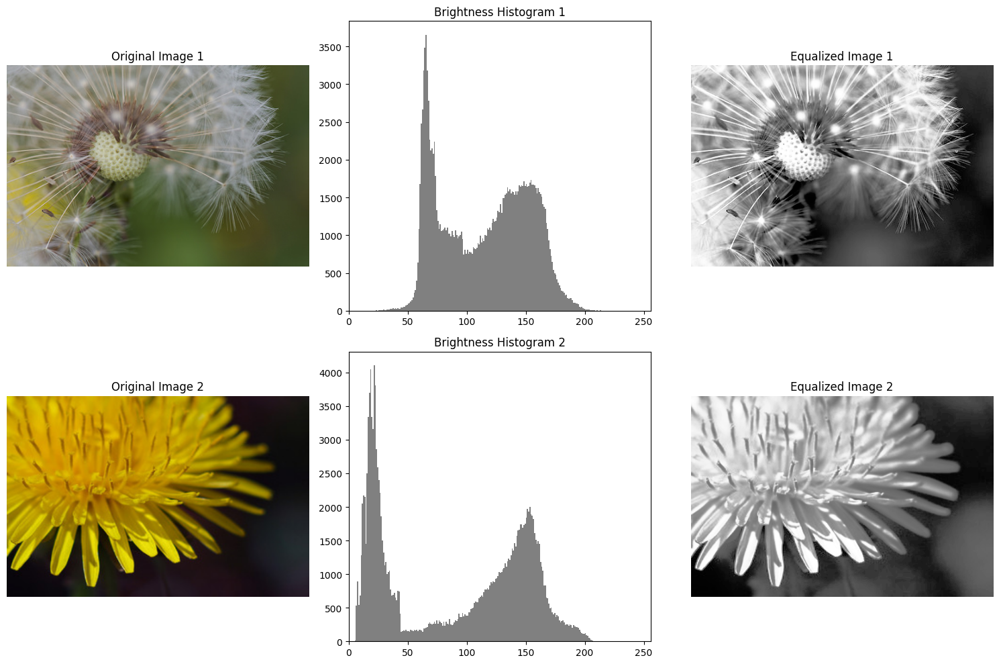

In [17]:
plt.figure(figsize=(15, 10))

# image 1 
plt.subplot(2, 3, 1)
plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
plt.title('Original Image 1')
plt.axis('off')

plt.subplot(2, 3, 2)
plt.hist(gray_image1.ravel(), bins=256, range=[0, 256], color='gray')
plt.title('Brightness Histogram 1')
plt.xlim([0, 256])

plt.subplot(2, 3, 3)
plt.imshow(equalized_image1, cmap='gray')
plt.title('Equalized Image 1')
plt.axis('off')

# image 2 
plt.subplot(2, 3, 4)
plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
plt.title('Original Image 2')
plt.axis('off')

plt.subplot(2, 3, 5)
plt.hist(gray_image2.ravel(), bins=256, range=[0, 256], color='gray')
plt.title('Brightness Histogram 2')
plt.xlim([0, 256])

plt.subplot(2, 3, 6)
plt.imshow(equalized_image2, cmap='gray')
plt.title('Equalized Image 2')
plt.axis('off')

plt.tight_layout()
plt.show()

# CNN

In [18]:
img_height, img_width = 150, 150
batch_size = 16

In [19]:
train_datagen = ImageDataGenerator(
    rescale=1.0/255,
    validation_split=0.2 
)

In [20]:
train_generator = train_datagen.flow_from_directory(
    data_train,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

Found 2198 images belonging to 5 classes.


In [21]:
validation_generator = train_datagen.flow_from_directory(
    data_train,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

Found 548 images belonging to 5 classes.


In [22]:
train_datagen = ImageDataGenerator(
    rescale=1.0/255,       
    rotation_range=40,         
    height_shift_range=0.2,   
    shear_range=0.2,          
    zoom_range=0.2,           
    horizontal_flip=True,    
    fill_mode='nearest',    
    validation_split=0.2)

In [23]:
input_shape=(img_height, img_width, 3)

In [24]:
num_classes = train_generator.num_classes  

model = Sequential()

model.add(Conv2D(32, (3, 3), input_shape=(img_height, img_width, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Flatten())

model.add(Dense(128, activation='relu'))
model.add(Dropout(0.5))

model.add(Dense(num_classes, activation='softmax'))

In [25]:
# Hyperparameters for tuning
optimizer = 'rmsprop'
learning_rate = 0.001
regularization = l2(0.01)
optimizer = 'adam'
learning_rate = 0.001
regularization = l1(0.01)
dropout_rate = 0.01

In [26]:
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [27]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 148, 148, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 74, 74, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 74, 74, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 72, 72, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 36, 36, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 36, 36, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 82944)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    10,616,960 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 5)              │           645 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 10,636,997 (40.58 MB)

 Trainable params: 10,636,997 (40.58 MB)

 Non-trainable params: 0 (0.00 B)

In [28]:
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

In [29]:
history = model.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=10,  
    callbacks=[early_stopping],
    verbose = 1
)

Epoch 1/10
138/138 ━━━━━━━━━━━━━━━━━━━━ 59s 402ms/step - accuracy: 0.3157 - loss: 2.2925 - val_accuracy: 0.4215 - val_loss: 1.3310
Epoch 2/10
138/138 ━━━━━━━━━━━━━━━━━━━━ 53s 380ms/step - accuracy: 0.5477 - loss: 1.1383 - val_accuracy: 0.5164 - val_loss: 1.1618
Epoch 3/10
138/138 ━━━━━━━━━━━━━━━━━━━━ 52s 378ms/step - accuracy: 0.6158 - loss: 0.9922 - val_accuracy: 0.5858 - val_loss: 1.0584
Epoch 4/10
138/138 ━━━━━━━━━━━━━━━━━━━━ 52s 374ms/step - accuracy: 0.6871 - loss: 0.8284 - val_accuracy: 0.6022 - val_loss: 1.0597
Epoch 5/10
138/138 ━━━━━━━━━━━━━━━━━━━━ 53s 381ms/step - accuracy: 0.7718 - loss: 0.6176 - val_accuracy: 0.6204 - val_loss: 1.0283
Epoch 6/10
138/138 ━━━━━━━━━━━━━━━━━━━━ 53s 384ms/step - accuracy: 0.8566 - loss: 0.4326 - val_accuracy: 0.6296 - val_loss: 1.0996
Epoch 7/10
138/138 ━━━━━━━━━━━━━━━━━━━━ 55s 397ms/step - accuracy: 0.8620 - loss: 0.3728 - val_accuracy: 0.6113 - val_loss: 1.1652
Epoch 8/10
138/138 ━━━━━━━━━━━━━━━━━━━━ 53s 380ms/step - accuracy: 0.9193 - loss: 0

In [30]:
val_loss, val_accuracy = model.evaluate(validation_generator)
print(f'Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.4f}')

35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 93ms/step - accuracy: 0.6187 - loss: 1.0519
Validation Loss: 1.0283, Validation Accuracy: 0.6204


In [31]:
validation_loss, validation_accuracy = model.evaluate(validation_generator)
print(f"Validation Accuracy: {validation_accuracy * 100:.2f}%")

35/35 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - accuracy: 0.6102 - loss: 1.0569
Validation Accuracy: 62.04%


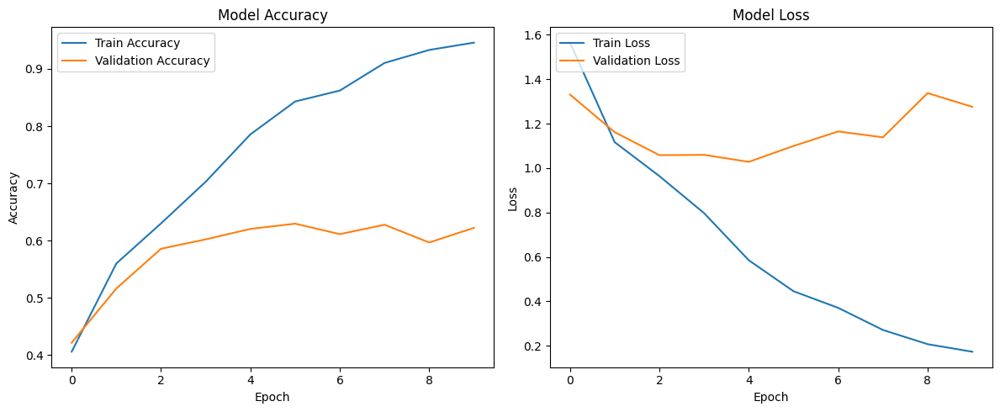

In [32]:
plt.figure(figsize=(12, 5))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper left')

plt.tight_layout()
plt.show()

# Dự Đoán Hoa

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


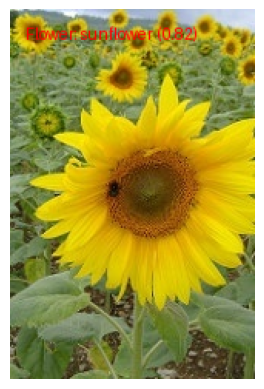

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


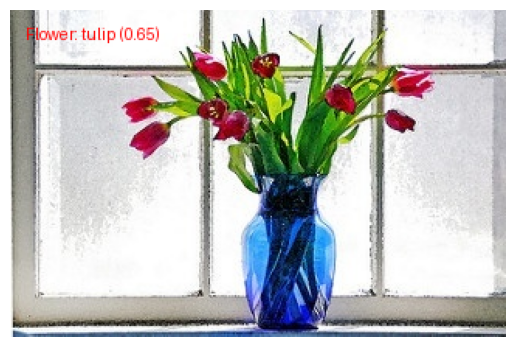

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


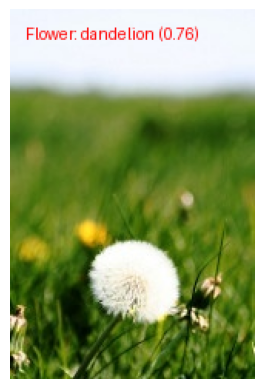

In [50]:
import numpy as np
import cv2
from tensorflow.keras.preprocessing import image
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt

# Hàm dự đoán loại hoa cho một ảnh đầu vào
def predict_flower(image_path, model, img_height=150, img_width=150):
    # Tải và xử lý ảnh đầu vào
    img = image.load_img(image_path, target_size=(img_height, img_width))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Thêm một chiều để thành batch size 1
    img_array = img_array / 255.0  # Chuẩn hóa giống như khi huấn luyện

    # Thực hiện dự đoán
    predictions = model.predict(img_array)
    predicted_class_index = np.argmax(predictions, axis=1)[0]  # Lấy lớp có xác suất cao nhất

    # Tên các lớp (nhãn) từ train_generator
    class_labels = list(train_generator.class_indices.keys())
    predicted_class_label = class_labels[predicted_class_index]

    # Xác suất dự đoán
    confidence = predictions[0][predicted_class_index]

    # Trả về nhãn dự đoán và xác suất
    return predicted_class_label, confidence

# Hàm xử lý 3 ảnh đầu vào và hiển thị 3 ảnh đầu ra
def process_multiple_images(image_paths, model):
    for image_path in image_paths:
        # Dự đoán loại hoa và xác suất
        predicted_class, confidence = predict_flower(image_path, model)

        # Tạo văn bản để hiển thị trên ảnh
        text = f"Flower: {predicted_class} ({confidence:.2f})"

        # Load ảnh bằng OpenCV
        image = cv2.imread(image_path)

        # Chuyển ảnh sang định dạng PIL để thêm chữ
        image_pil = Image.fromarray(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        draw = ImageDraw.Draw(image_pil)

        # Chọn font chữ và kích thước, sử dụng font in đậm
        font_path = "arialbd.ttf"  # Đảm bảo rằng font này có sẵn hoặc thay bằng đường dẫn tới font in đậm bạn muốn dùng
        font_size = 24
        try:
            font = ImageFont.truetype(font_path, font_size)
        except IOError:
            font = ImageFont.load_default()

        # Màu chữ (màu đỏ)
        text_color = (255, 0, 0)

        # Thêm chữ vào ảnh
        draw.text((10, 10), text, font=font, fill=text_color)

        # Chuyển đổi lại sang định dạng của OpenCV
        output_image = np.array(image_pil)

        # Hiển thị ảnh với văn bản ghi chú sử dụng matplotlib
        plt.imshow(output_image)
        plt.axis('off')  # Tắt các trục tọa độ
        plt.show()

# INPUT: Danh sách các ảnh đầu vào
image_paths = [
    '/kaggle/input/flowers-dataset/test/Image_9.jpg',
    '/kaggle/input/flowers-dataset/test/Image_6.jpg',
    '/kaggle/input/flowers-dataset/test/Image_3.jpg'
]

# Giả sử bạn đã có mô hình `model` đã được huấn luyện từ trước
# Thực hiện dự đoán và hiển thị kết quả cho 3 ảnh
process_multiple_images(image_paths, model)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


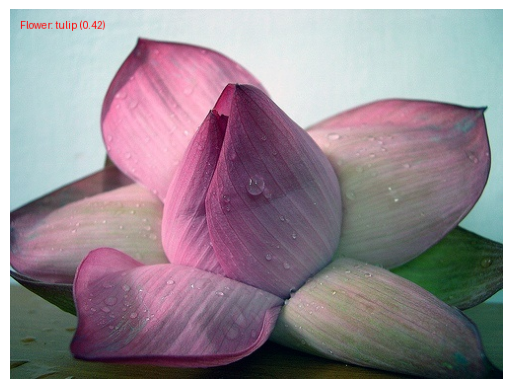

# CAC THUAT TOAN CHUONG 9 XLA

# Gọi thư viện cần thiết

In [36]:
import numpy as np
from PIL import Image, ImageFont, ImageDraw
from PIL.ImageChops import add, subtract, multiply, difference, screen
import PIL.ImageStat as stat
from skimage.io import imread, imsave, imshow, show, imread_collection, imshow_collection
from skimage import color, exposure, img_as_float, data
from skimage.transform import SimilarityTransform, warp, swirl
from skimage.util import invert, random_noise, montage
import matplotlib.image as mpimg
import matplotlib.pylab as plt
from scipy.ndimage import affine_transform, zoom
from scipy import misc

# K-means clustering for image segmentation with color quantization

Ảnh ban đầu 

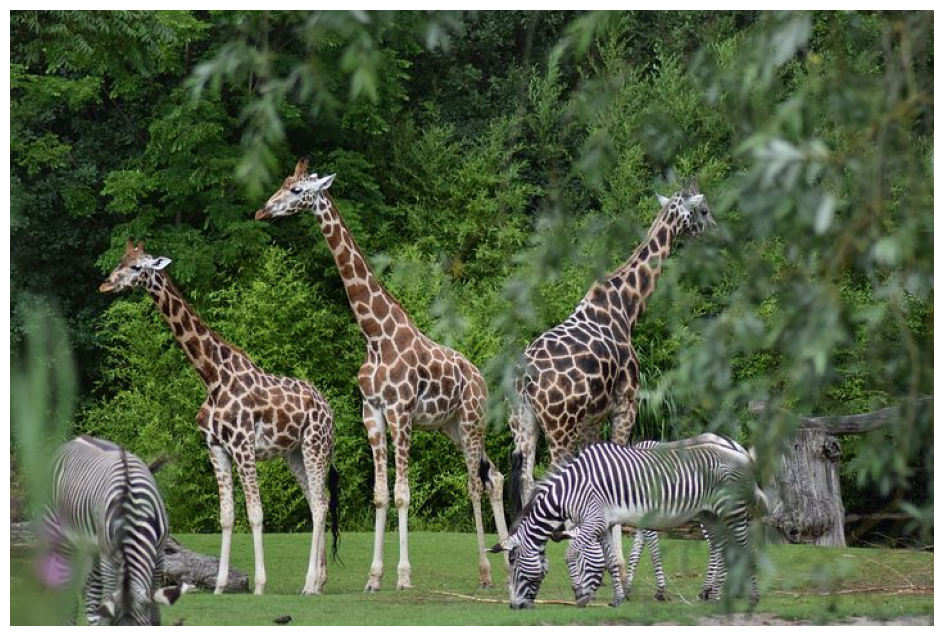

In [37]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến bức ảnh đầu tiên
img_path = "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"

# Mở ảnh 
img = Image.open(img_path)

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(12, 8))

# Hiển thị bức ảnh xám
plt.imshow(img)  # Đặt `cmap='gray'` để hiển thị ảnh xám

# Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.axis('off')

# Hiển thị ảnh
plt.show()

Ảnh sau xử lý 

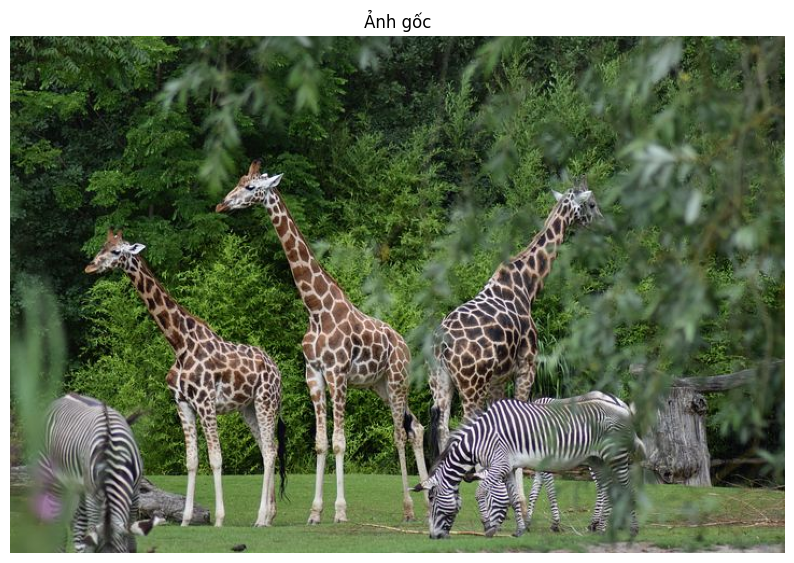

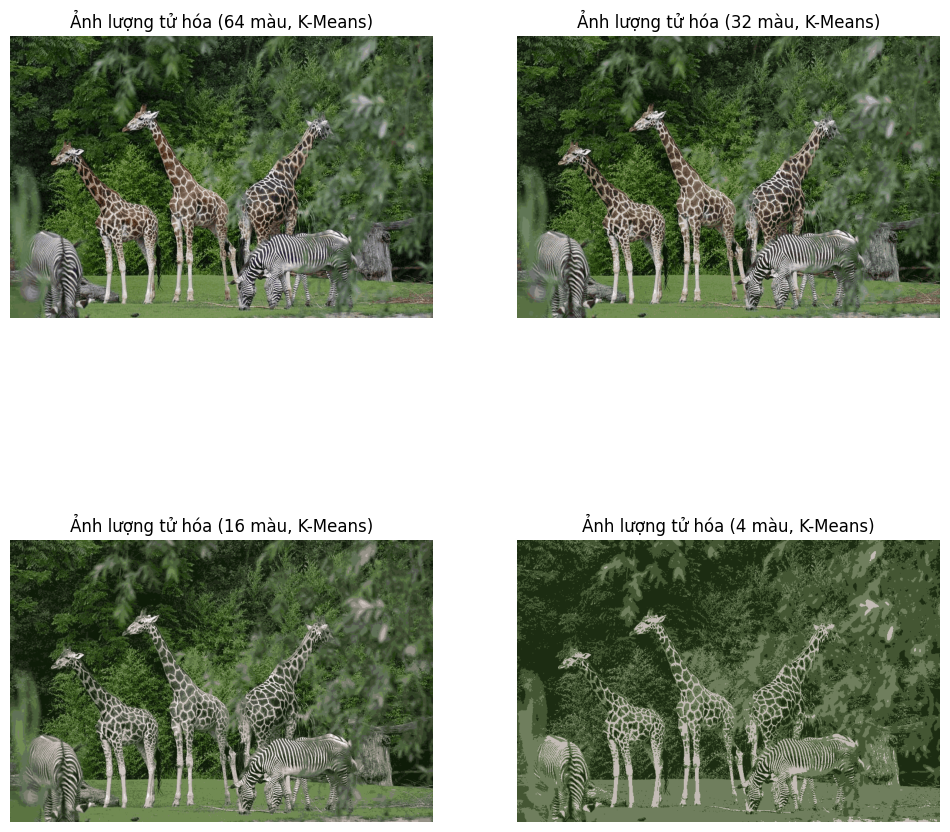

In [38]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.utils import shuffle
from PIL import Image
import time

# Đường dẫn đến ảnh đầu vào
img_path = "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"

# Mở và chuyển ảnh sang dạng float để thực hiện việc lượng tử hóa màu
img = Image.open(img_path)
img = np.array(img, dtype=np.float64) / 255  # Chuyển đổi thành dạng float trong khoảng [0, 1]

# Lấy kích thước ảnh và chuyển đổi thành mảng 2D
w, h, d = img.shape
image_array = np.reshape(img, (w * h, d))

# Hàm để tái tạo lại ảnh từ các cụm màu và nhãn
def recreate_image(codebook, labels, w, h):
    """Tái tạo ảnh từ codebook (bảng màu) và nhãn"""
    d = codebook.shape[1]
    image = np.zeros((w, h, d))
    label_idx = 0
    for i in range(w):
        for j in range(h):
            image[i][j] = codebook[labels[label_idx]]
            label_idx += 1
    return image

# Hiển thị ảnh gốc
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.title('Ảnh gốc')
plt.imshow(img)

# Áp dụng k-means với số lượng màu giảm dần
plt.figure(figsize=(12, 12))
for i, n_colors in enumerate([64, 32, 16, 4], 1):
    # Chọn mẫu ngẫu nhiên từ dữ liệu
    image_array_sample = shuffle(image_array, random_state=0)[:1000]
    
    # Thực hiện k-means
    kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(image_array_sample)
    
    # Dự đoán màu cho toàn bộ ảnh
    labels = kmeans.predict(image_array)
    
    # Tạo lại ảnh với bảng màu từ k-means
    quantized_img = recreate_image(kmeans.cluster_centers_, labels, w, h)
    
    # Hiển thị ảnh đã lượng tử hóa
    plt.subplot(2, 2, i)
    plt.axis('off')
    plt.title(f'Ảnh lượng tử hóa ({n_colors} màu, K-Means)')
    plt.imshow(quantized_img)

plt.show()


# Spectral Clustering for Image Segmentation

Ảnh ban đầu 

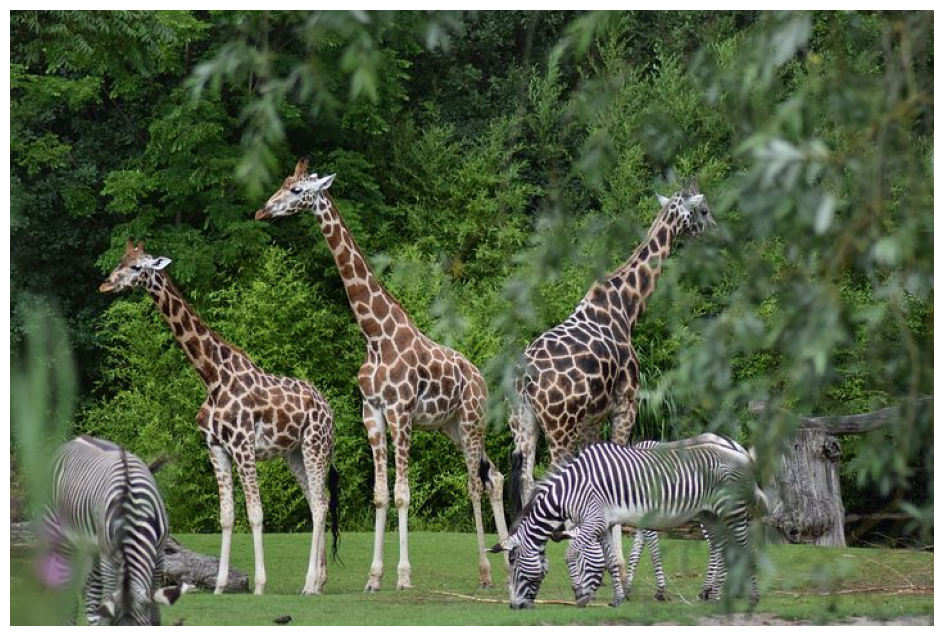

In [39]:
from PIL import Image
import matplotlib.pyplot as plt

# Đường dẫn đến bức ảnh đầu tiên
img_path = "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"

# Mở ảnh 
img = Image.open(img_path)

# Tạo một cửa sổ hiển thị với kích thước lớn
plt.figure(figsize=(12, 8))

# Hiển thị bức ảnh xám
plt.imshow(img)  # Đặt `cmap='gray'` để hiển thị ảnh xám

# Tắt hiển thị trục tọa độ x và y để ảnh nhìn đẹp hơn
plt.axis('off')

# Hiển thị ảnh
plt.show()

Ảnh sau xử lý 

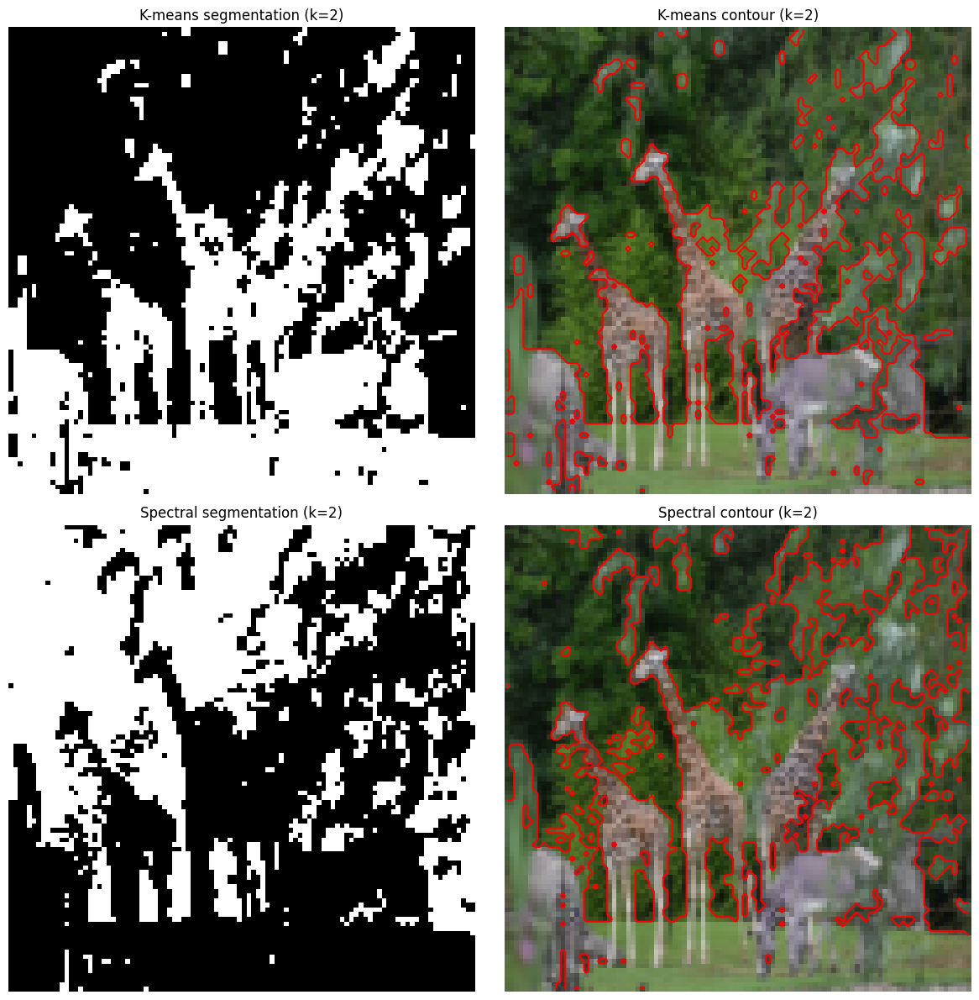

In [40]:
import numpy as np
from sklearn import cluster
from skimage.io import imread
from skimage.color import rgb2gray
import matplotlib.pyplot as plt
from skimage.transform import resize

# Đường dẫn đến ảnh đầu vào
img_path = "/kaggle/input/data-btl-xla/images/giraffe_zebra.jpg"

# Mở và thay đổi kích thước ảnh
im = resize(imread(img_path), (100, 100), anti_aliasing=True)
img = rgb2gray(im)  # Chuyển ảnh thành ảnh xám để xử lý

# Định dạng lại ảnh thành mảng 2D để dùng cho phân cụm
X = np.reshape(im, (-1, im.shape[-1]))

# Số cụm cho phân cụm nhị phân (foreground và background)
k = 2  

# Phân cụm K-means
two_means = cluster.MiniBatchKMeans(n_clusters=k, random_state=10)
two_means.fit(X)
y_pred_kmeans = two_means.predict(X)
labels_kmeans = np.reshape(y_pred_kmeans, img.shape)

# Phân cụm phổ (Spectral Clustering)
spectral = cluster.SpectralClustering(n_clusters=k, eigen_solver='arpack',
                                      affinity="nearest_neighbors", n_neighbors=10, random_state=10)
spectral.fit(X)
y_pred_spectral = spectral.labels_
labels_spectral = np.reshape(y_pred_spectral, img.shape)

# Hiển thị kết quả
plt.figure(figsize=(12, 12))

# Ảnh phân đoạn bằng k-means
plt.subplot(221)
plt.imshow(labels_kmeans, cmap='gray')
plt.title('K-means segmentation (k=2)')
plt.axis('off')

# Contour k-means trên ảnh gốc
plt.subplot(222)
plt.imshow(im)
plt.contour(labels_kmeans == 0, contours=1, colors='red')
plt.axis('off')
plt.title('K-means contour (k=2)')

# Ảnh phân đoạn bằng Spectral Clustering
plt.subplot(223)
plt.imshow(labels_spectral, cmap='gray')
plt.title('Spectral segmentation (k=2)')
plt.axis('off')

# Contour Spectral Clustering trên ảnh gốc
plt.subplot(224)
plt.imshow(im)
plt.contour(labels_spectral == 0, contours=1, colors='red')
plt.axis('off')
plt.title('Spectral contour (k=2)')

plt.tight_layout()
plt.show()
